In [1]:
import xarray as xr
import numpy as np

import rasterio
from rasterio.transform import from_origin
from rasterio.crs import CRS
from rasterio.mask import mask
from rasterio.merge import merge
from rasterio import Affine
from rasterio.warp import calculate_default_transform, reproject, Resampling

import os
import geopandas as gpd
import pandas as pd
import matplotlib.pyplot as plt
from pathlib import Path

In [2]:
# Only Buffer Polygons along coastline without overlapping regions of neighbouring boundaries
# https://gis.stackexchange.com/questions/434355/buffer-polygons-without-overlapping-regions-of-neighbouring-boundaries-in-arcgis
# 
# 1. Buffer the boundary shapefile with dissolve type= all, i.e. bf = 10km
#  Because The NZClimate shapefile's projection is WGS84, I reproject it to NZTM before buffering. 
#  Boundary shapefile in WGS84 - E:\Tuflow\Cal_rainfall_timeseries\data\NZ_ClimateZone\NZClimate.shp
#  Boundary shapefile in NZTM  - E:\Tuflow\Cal_rainfall_timeseries\data\NZ_ClimateZone\NZClimate_NZTM.shp
#  Buffered shapefile          - temporary file, NZClimate_pro_bf10km
# 
# 2. Calculate the Euclidean Allocation of the original boundary shapefile, and set up Euclidean Allocation tool as below
#  2.1   calculate the Euclidean Allocation by the 'id' field, i.e. the 'FID' filed of NZClimate_NZTM.shp
#  2.2   the maximum distance is set to the buffer distance used in step 1, i.e.  maximum distance = 10km
#  2.3   use the buffered shapefile's extent in environment setting when processing 
#  2.4   set the output cellsize to a small value, i.e. output cellsize = 10m
#  output raster in NZTM  - temporary file, EucAllo_NZCl5
# 
# 3. Convert the raster output in step 2 to polygons 
#  output polygon in NZTM - E:\Tuflow\Cal_rainfall_timeseries\data\NZ_ClimateZone\NZClimate_bf10km_NZTM.shp
# 
# 4. Project the new polygons to WGS84
#  Projected polygon in WGS84 - E:\Tuflow\Cal_rainfall_timeseries\data\NZ_ClimateZone\NZClimate_bf10km.shp


In [3]:
ARI = 100 #a

In [4]:
# Region polygon shapefile
gdf_Pilbara = gpd.read_file('/home/lusun/LuSUN/Data/riotinto_mash/catchment_boundary/watershed_WGS84_without_offshore_islands_filledholes_dissolved.shp')
gdf_Pilbara

,id,geometry
0,1,"POLYGON ((118.74750 -20.29250, 118.74750 -20.3..."


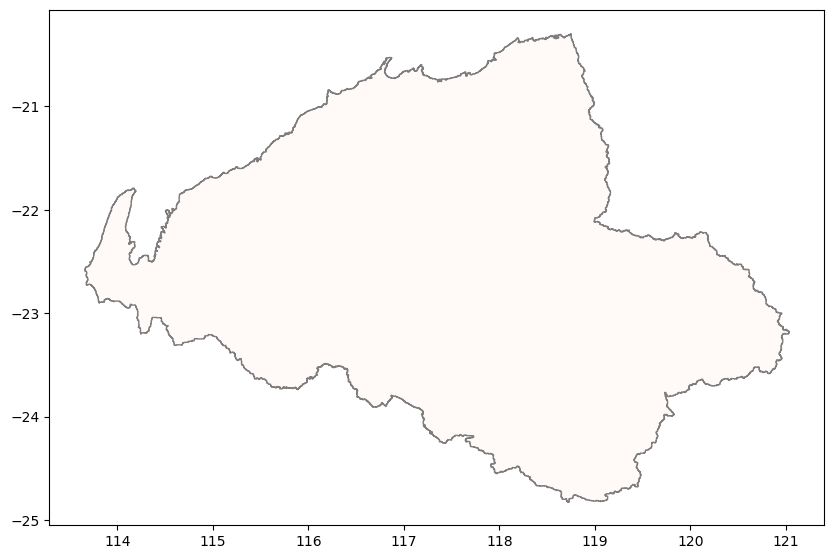

In [5]:
# Plot the shapefiles
fig, ax = plt.subplots(figsize=(10, 10))
gdf_Pilbara.plot(ax=ax, cmap='Reds', alpha=0.5, edgecolor='k')
# Add labels to the plot
plt.show()

In [6]:
# Read HIRDS v4 data, ARI=100, duration=24.0
# ARI = 100 #a

# data_file = r"E:\Tuflow\Cal_rainfall_timeseries\data\New Zealand_Extreme_Precipitation_baseline_NIWA.nc"
data_dir=  Path("/home/lusun/LuSUN/Data/riotinto_mash")
chunks = {'time':-1}
precip_files = list(sorted(data_dir.joinpath("all_durations").glob("*Precipitation*.nc4")))
base_data  = xr.open_mfdataset(precip_files, 
                            # engine='h5netcdf',
                            #engine='netcdf4',
                            # preprocess=preprocess, 
                            chunks=chunks)#.prec.sel(time=slice("1991","2020")) #"1991", '2020'

base_data = base_data['Extreme_Precipitation'].sel(ari=ARI, hrs=24.0).drop(["ari"]).rename({"lat": "latitude", "lon":"longitude"})
base_data .rio.write_crs("epsg:4326", inplace=True)
base_data 


<xarray.DataArray 'Extreme_Precipitation' (latitude: 1361, longitude: 1761)>
dask.array<getitem, shape=(1361, 1761), dtype=float32, chunksize=(1361, 1761), chunktype=numpy.ndarray>
Coordinates:
  * latitude     (latitude) float64 -9.787 -9.812 -9.837 ... -43.76 -43.79
  * longitude    (longitude) float64 110.4 110.4 110.4 ... 154.3 154.4 154.4
    hrs          float64 24.0
    spatial_ref  int64 0
Attributes:
    units:       mm
    regenerate:  http://www.climsystems.com J.Yu 2023-07-03
    source:      Australia Govemment Bureau of Meteorology Design Rainfall Da...

In [7]:
# write nc data as a geotiff
def save_xr_as_tiff(xr_data, output_path):
    # Specify the spatial information
    lon = xr_data['longitude']
    lat = xr_data['latitude']
    lon_min, lon_max = lon.min().values, lon.max().values
    lat_min, lat_max = lat.min().values, lat.max().values
    resolution = abs(lon[1] - lon[0]).values  # Assuming equal spacing

    # Create the transform for the GeoTIFF
    transform = from_origin(lon_min, lat_max, resolution, resolution)

    # Convert the DataArray to a numpy array
    array = xr_data.values

    # Write the array as a GeoTIFF
    with rasterio.open(output_path, 'w', driver='GTiff', height=array.shape[0],
                       width=array.shape[1], count=1, dtype=array.dtype,
                       crs='EPSG:4326', transform=transform) as dst:
        dst.write(array, 1)
        

In [8]:
output_path = '/home/lusun/LuSUN/output/P24_ARI' + str(ARI) + '_Pilbara.tif'
save_xr_as_tiff(base_data , output_path)


In [9]:
# Read regional temporal curve
output_path = '/home/lusun/LuSUN/output/'
prep_dist = output_path + 'baseline_regional_pdfs_ARI' + str(ARI) + '_byPilbaraClimate.csv'
prep_dist_df = pd.read_csv(prep_dist, sep=',')

<Axes: >

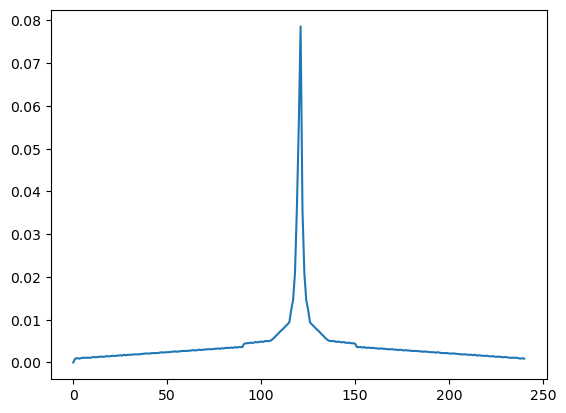

In [22]:
prep_dist_df
prep_dist_df['Pilbara'].plot()

In [11]:
# Cal rainfall time series for each grid
def Generate_rainfall_timeseries_24hr_region(P24, prep_dist_df, region):
    print(region)
    P = P24 * prep_dist_df[region].values
    Px = P.cumsum()
    Px[-1] = P24
    P[-1] = P24 - Px[-2]
    return P

In [12]:

times = prep_dist_df['hours'].values
ntimes = len(times)
times

array([ 0. ,  0.1,  0.2,  0.3,  0.4,  0.5,  0.6,  0.7,  0.8,  0.9,  1. ,
        1.1,  1.2,  1.3,  1.4,  1.5,  1.6,  1.7,  1.8,  1.9,  2. ,  2.1,
        2.2,  2.3,  2.4,  2.5,  2.6,  2.7,  2.8,  2.9,  3. ,  3.1,  3.2,
        3.3,  3.4,  3.5,  3.6,  3.7,  3.8,  3.9,  4. ,  4.1,  4.2,  4.3,
        4.4,  4.5,  4.6,  4.7,  4.8,  4.9,  5. ,  5.1,  5.2,  5.3,  5.4,
        5.5,  5.6,  5.7,  5.8,  5.9,  6. ,  6.1,  6.2,  6.3,  6.4,  6.5,
        6.6,  6.7,  6.8,  6.9,  7. ,  7.1,  7.2,  7.3,  7.4,  7.5,  7.6,
        7.7,  7.8,  7.9,  8. ,  8.1,  8.2,  8.3,  8.4,  8.5,  8.6,  8.7,
        8.8,  8.9,  9. ,  9.1,  9.2,  9.3,  9.4,  9.5,  9.6,  9.7,  9.8,
        9.9, 10. , 10.1, 10.2, 10.3, 10.4, 10.5, 10.6, 10.7, 10.8, 10.9,
       11. , 11.1, 11.2, 11.3, 11.4, 11.5, 11.6, 11.7, 11.8, 11.9, 12. ,
       12.1, 12.2, 12.3, 12.4, 12.5, 12.6, 12.7, 12.8, 12.9, 13. , 13.1,
       13.2, 13.3, 13.4, 13.5, 13.6, 13.7, 13.8, 13.9, 14. , 14.1, 14.2,
       14.3, 14.4, 14.5, 14.6, 14.7, 14.8, 14.9, 15

In [29]:
import Jpkg as J
tmp = J.fshape2xr(base_data.rename({'latitude':'lat', 'longitude':'lon'}), gdf_Pilbara)#.rename({'latitude':'lat', 'longitude':'lon'})
tmp.lon[1]-tmp.lon[0]
tmp.lat[1]-tmp.lat[0]

base_data

<xarray.DataArray 'Extreme_Precipitation' (latitude: 1361, longitude: 1761)>
dask.array<getitem, shape=(1361, 1761), dtype=float32, chunksize=(1361, 1761), chunktype=numpy.ndarray>
Coordinates:
  * latitude     (latitude) float64 -9.787 -9.812 -9.837 ... -43.76 -43.79
  * longitude    (longitude) float64 110.4 110.4 110.4 ... 154.3 154.4 154.4
    hrs          float64 24.0
    spatial_ref  int64 0
Attributes:
    units:       mm
    regenerate:  http://www.climsystems.com J.Yu 2023-07-03
    source:      Australia Govemment Bureau of Meteorology Design Rainfall Da...

In [27]:
times = prep_dist_df['hours'].values
ntimes = len(times)

regions = ['Pilbara']
region = 'Pilbara'

nrows, ncols = tmp.shape
result_arr = np.zeros((nrows, ncols, ntimes))
for i in range(nrows):
    for j in range(ncols):
        x = tmp[i,j].values
        y = prep_dist_df
        print(x)
        print(y)
        if x != 0.0 and x!= -9999.0:
            result = Generate_rainfall_timeseries_24hr_region(x, y, region)
            result_arr[i, j, :] = result
        else:
            result_arr[i, j, :] = -999.0
                
    # save time series as tif
for ind_time in range(len(times)):

    time = times[ind_time]
    data = result_arr[:, :, ind_time]

    spatial_resolution = 0.025
    crs = "EPSG:4326"

    # out_path = r'E:\Tuflow\Cal_rainfall_timeseries\output\byNZClimate\baseline\timeseries\tmp\ARI' + str(ARI) + '\\Pt_region'+ '\\' + str(time)
    out_path = '/home/lusun/LuSUN/output/ARI' + str(ARI) + '/Pt_region'+ '/' + str(time)
    if not os.path.exists(out_path):
        os.makedirs(out_path)
    out_tif = out_path + '/Pt_ARI' + str(ARI) + '_' + region + '_' + str(time) + '.tif'
    with rasterio.open(out_tif, 
                       'w',
                       driver = 'GTiff',
                       height = tmp.shape[0],
                       width = tmp.shape[1],
                       count = 1,
                       dtype = str(tmp.dtype),
                       crs = crs,
                       transform = from_origin(tmp.coords['lon'][0],tmp.coords['lat'][0], spatial_resolution, spatial_resolution) 
                       ) as dst:
        dst.write(data, 1)

print('finished!')

nan
     hours  Pilbara
0      0.0   0.0000
1      0.1   0.0009
2      0.2   0.0010
3      0.3   0.0009
4      0.4   0.0010
..     ...      ...
236   23.6   0.0011
237   23.7   0.0010
238   23.8   0.0009
239   23.9   0.0010
240   24.0   0.0009

[241 rows x 2 columns]
Pilbara
nan
     hours  Pilbara
0      0.0   0.0000
1      0.1   0.0009
2      0.2   0.0010
3      0.3   0.0009
4      0.4   0.0010
..     ...      ...
236   23.6   0.0011
237   23.7   0.0010
238   23.8   0.0009
239   23.9   0.0010
240   24.0   0.0009

[241 rows x 2 columns]
Pilbara
nan
     hours  Pilbara
0      0.0   0.0000
1      0.1   0.0009
2      0.2   0.0010
3      0.3   0.0009
4      0.4   0.0010
..     ...      ...
236   23.6   0.0011
237   23.7   0.0010
238   23.8   0.0009
239   23.9   0.0010
240   24.0   0.0009

[241 rows x 2 columns]
Pilbara
nan
     hours  Pilbara
0      0.0   0.0000
1      0.1   0.0009
2      0.2   0.0010
3      0.3   0.0009
4      0.4   0.0010
..     ...      ...
236   23.6   0.0011
237   23

In [45]:
# # Cal rainfall timeseries by region

# regions = ['Pilbara']
# region = 'Pilbara'

# times = prep_dist_df['hours'].values
# ntimes = len(times)


# # P24_file = r'E:\Tuflow\Cal_rainfall_timeseries\output\byNZClimate\baseline\P24\P24_ARI' + str(ARI) + '_NZ_full.tif'
# P24_file = '/home/lusun/LuSUN/output/P24_ARI' + str(ARI) + '_Pilbara.tif'
# with rasterio.open(P24_file) as src:
#     P24_ras = src.read(1)  # Read the first band of the raster
#     meta = src.meta.copy()  
#     # print('meta0', meta)

# #############################################################################

# # If more climate zones in Australia are included, loop will have to be used. 

# ##############################################################################

# # for index, row in gdf_Pilbara.iterrows():
    
# # region = row[1]
# # regions.append(region)
    
# geometry = gdf_Pilbara.geometry
# # Perform the raster clipping
# clipped_raster, clipped_transform = mask(dataset=rasterio.open(P24_file), shapes=[geometry], crop=True)
# # Update the metadata with the clipped raster dimensions and transformation
# meta.update({'height': clipped_raster.shape[1], 'width': clipped_raster.shape[2], 'transform': clipped_transform})
# # print('meta', index+1, meta)
# arr = clipped_raster[0]
    

# nrows, ncols = arr.shape
# result_arr = np.zeros((nrows, ncols, ntimes))
# for i in range(nrows):
#     for j in range(ncols):
#         x = arr[i,j]
#         y = prep_dist_df
#         if x != 0.0 and x!= -9999.0:
#             result = Generate_rainfall_timeseries_24hr_region(x, y, region)
#             result_arr[i, j, :] = result
#         else:
#             result_arr[i, j, :] = -999.0
                
#     # save time series as tif
# for ind_time in range(len(times)):

#     time = times[ind_time]
#     data = result_arr[:, :, ind_time]

#     # out_path = r'E:\Tuflow\Cal_rainfall_timeseries\output\byNZClimate\baseline\timeseries\tmp\ARI' + str(ARI) + '\\Pt_region'+ '\\' + str(time)
#     out_path = '/home/lusun/LuSUN/output/ARI' + str(ARI) + '/Pt_region'+ '/' + str(time)
#     if not os.path.exists(out_path):
#         os.makedirs(out_path)
#     out_tif = out_path + '/Pt_ARI' + str(ARI) + '_' + region + '_' + str(time) + '.tif'
#     with rasterio.open(out_tif, 'w', **meta) as dst:
#         dst.write(data, 1)

# print('finished!')

In [ ]:
clipped_raster.shape

In [ ]:
arr.shape

In [ ]:
clipped_transform

In [ ]:
gdf_nz_bf

In [ ]:
gdf

In [ ]:
geometry

In [ ]:
bounds.values[0]

In [ ]:
west, south, east, north

In [ ]:
width, height

In [ ]:
df_ddfs

In [ ]:
regions

In [ ]:
# Merge timeseries from regionals to NZ

def merge_rasters(input_rasters, output_raster):
    # Open each raster file
    src_files = []
    for file in input_rasters:
        with rasterio.open(file) as src:
            src_files.append(src)

    # Merge the rasters
    mosaic, out_trans = merge(src_files, nodata=-999.0)
    
    out_meta = src.meta.copy()
    out_meta.update({"driver": "GTiff",
                 "height": mosaic.shape[1],
                 "width": mosaic.shape[2],
                 "transform": out_trans,
                 "nodata": -999.0})

    # Save the merged raster
    with rasterio.open(output_raster, 'w', **out_meta) as dst:
        dst.write(mosaic)

In [ ]:
for time in times:
    
    in_tifs = []
    for region in regions:
        time_series_path = r'E:\Tuflow\Cal_rainfall_timeseries\output\byNZClimate\baseline\timeseries\tmp\ARI' + str(ARI) + '\\Pt_region'+ '\\' + str(time)
        in_tif = time_series_path + '\\Pt_ARI' + str(ARI) + '_' + region + '_' + str(time) + '.tif'
        in_tifs.append(in_tif)

    src_files = []
    for file in in_tifs:
        src = rasterio.open(file)
        src_files.append(src)

    # merge the rasters
    mosaic, out_trans = merge(src_files, nodata=-999.0)

    # create the output raster file
    out_meta = src.meta.copy()
    out_meta.update({"driver": "GTiff",
                     "height": mosaic.shape[1],
                     "width": mosaic.shape[2],
                     "transform": out_trans,
                     "nodata": -999.0})
    
    
    merge_path =  r'E:\Tuflow\Cal_rainfall_timeseries\output\byNZClimate\baseline\timeseries\latlon\ARI' + str(ARI) + '\Pt_NZ'
    if not os.path.exists(merge_path):
        os.makedirs(merge_path)
    merge_tif =  merge_path + '\\' + 'Pt_ARI' + str(ARI) + '_' + str(time) + '.tif'
    with rasterio.open(merge_tif, "w", **out_meta) as dest:
        dest.write(mosaic)

print('finished')

In [ ]:
# Check if sum(Pt) == P24

raster_files = []
for time in times:
    
    raster_file =  r'E:\Tuflow\Cal_rainfall_timeseries\output\byNZClimate\baseline\timeseries\latlon\ARI' + str(ARI) + '\Pt_NZ\Pt_ARI' + str(ARI) + '_' + str(time) + '.tif'
    raster_files.append(raster_file)

# Open the first raster in read mode and initialize the sum array
with rasterio.open(raster_files[0]) as src1:
    sum_array = src1.read(1, masked=True)

    # Loop through the remaining rasters and add them to the sum array
    for filename in raster_files[1:]:
        with rasterio.open(filename) as src:
            data = src.read(1, masked=True)
            sum_array += data

# for Checking
# Write the sum array to a new raster file
with rasterio.open('sum_raster_new_ARI' + str(ARI) + '.tif', 'w', **src1.meta) as dst:
    dst.write(sum_array.filled(np.nan), 1)



In [5]:
# Reproject to NZTM

def reproject_ras(in_ras, out_ras): 

    # Open the input raster file in read mode
    with rasterio.open(in_ras) as src:

        # Define the output coordinate reference system (CRS) as NZTM
        dst_crs = 'EPSG:2193'

        # Calculate the affine transform and output dimensions for the destination raster
        transform, width, height = calculate_default_transform(src.crs, dst_crs, src.width, src.height, *src.bounds)

        # Create a dictionary of output raster parameters
        kwargs = src.meta.copy()
        kwargs.update({
            'crs': dst_crs,
            'transform': transform,
            'width': width,
            'height': height
        })

        # Open the output raster file in write mode and perform the reprojection
        with rasterio.open(out_ras, 'w', **kwargs) as dst:
            for i in range(1, src.count + 1):
                reproject(
                    source=rasterio.band(src, i),
                    destination=rasterio.band(dst, i),
                    src_transform=src.transform,
                    src_crs=src.crs,
                    dst_transform=transform,
                    dst_crs=dst_crs,
                    resampling=Resampling.nearest
                )
                



In [9]:

for time in times:
    ras_WGS84 = r'E:\Tuflow\Cal_rainfall_timeseries\output\byNZClimate\baseline\timeseries\latlon\\ARI' + str(ARI) + '\Pt_NZ\Pt_ARI' + str(ARI) + '_' + str(time) + '.tif'
    # NZTM_path = r'E:\Tuflow\Cal_rainfall_timeseries\output\byNZClimate\baseline\timeseries\NZTM\\ARI' + str(ARI) + '\geotiff'
    NZTM_path = r'E:\Tuflow\Cal_rainfall_timeseries\output\byNZClimate\baseline\timeseries\NZTM\ARI' + str(ARI) + '\\new_naming'
    if not os.path.exists(NZTM_path):
        os.makedirs(NZTM_path)
    # ras_NZTM = NZTM_path + '\\' + 'Pt_ARI' + str(ARI) + '_' + str(time) + '.tif'
    ras_NZTM = NZTM_path + '\\nz_baseline_' + str(ARI) + 'ari_t' + str(time) + '_precip.tif'
    reproject_ras(ras_WGS84, ras_NZTM)
